In [28]:
%%html
<script>
    var code_show=true; //true -> hide code at first

    function code_toggle() {
        if (code_show){
            $('div.input').hide();
            $('div.prompt').hide()
        } else {
            $('div.input').show();
            $('div.prompt').show()
        }
        code_show = !code_show
    }
    
    var button = document.createElement('button')
    button.className = 'btn btn-default'
    button.innerText = 'Toggle Input'
    var node = document.createElement('div')
    node.className = 'btn-group'
    node.appendChild(button)
    document.getElementsByClassName('btn-group')[0].parentNode.appendChild(node)
    $(button).click(code_toggle)
</script>

In [39]:
%matplotlib inline
from rocketpyBeta import *
from matplotlib.patches import Ellipse
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.plotly as py
import plotly.graph_objs as go
import plotly
plotly.offline.init_notebook_mode()

# Eupória I - Plano Final (Azimute L, Elevação 85, Balístico)

## Análise de Convergências do Método de Monte Carlo

Número de Simulações Realizadas:  39500


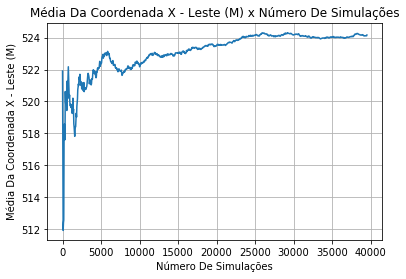

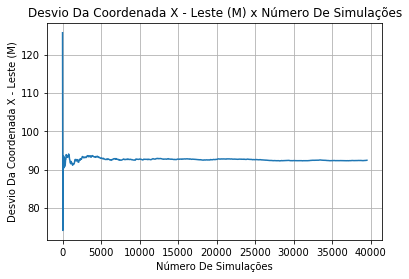

In [40]:
import glob
import numpy as np

MV, IV = [], []
X, Y, Z = [], [], []
RT, AT, TT = [], [], []
RV = []
AX, AY, DT, DX, DY, DZ = [], [], [], [], [], []
DV, MV, IV = [], [], []
SM = []
n = 0

for filename in glob.glob('*.euporia_I_FBB'):
    if filename[0:4] == 'OutD':
        n += 1
        rt, rv, mv, at, z, ax, ay, dt, dv, dx, dy, dz, tt, x, y, iv, sm = np.loadtxt(filename, delimiter=',', unpack=True)
        RT += rt.tolist()
        RV += rv.tolist()
        MV += mv.tolist()
        AT += at.tolist()
        Z += z.tolist()
        AX += ax.tolist()
        AY += ay.tolist()
        DT += dt.tolist()
        DV += dv.tolist()
        DX += dx.tolist()
        DY += dy.tolist()
        DZ += dz.tolist()
        TT += tt.tolist()
        X += x.tolist()
        Y += y.tolist()
        IV += iv.tolist()
        SM += sm.tolist()

i = 0
while i < len(X):
    if X[i] > 10000:
        X.remove(X[i])
        Y.remove(Y[i])
        Z.remove(Z[i])
    i += 1 
        
X += [0]
Y += [0]
print('Número de Simulações Realizadas: ', len(Z))
mean = Function(lambda x: np.mean(X[:int(x)]))
mean.setInputs('Número de Simulações')
mean.setOutputs('Média da Coordenada X - Leste (m)')
mean.plot(2, len(Z))
std = Function(lambda x: np.std(X[:int(x)]))
std.setInputs('Número de Simulações')
std.setOutputs('Desvio da Coordenada X - Leste (m)')
std.plot(2, len(Z))

## Elipses de Dispersão

Propabilidade de Impacto Fora das Elipses de Dispersão: 0.549 %


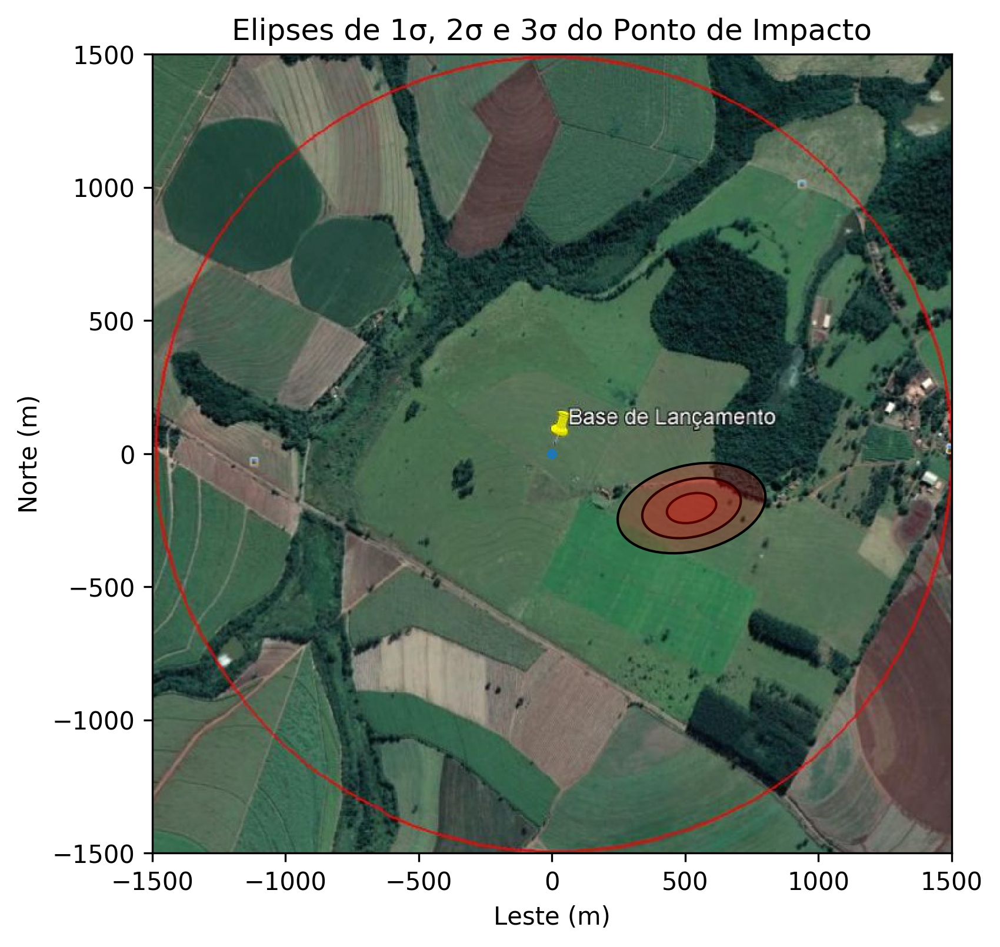

In [42]:
from scipy.misc import imread
img = imread("pontoFinal.jpg")
x = np.array(X)
y = np.array(Y)

def eigsorted(cov):
    vals, vecs = np.linalg.eigh(cov)
    order = vals.argsort()[::-1]
    return vals[order], vecs[:,order]

plt.figure(num=None, figsize=(8, 6), dpi=300, facecolor='w', edgecolor='k')
ax = plt.subplot(111)

cov = np.cov(x, y)
vals, vecs = eigsorted(cov)
theta = np.degrees(np.arctan2(*vecs[:,0][::-1]))
w, h = 2 * np.sqrt(vals)
#print(w, h)
#print(np.mean(x), np.mean(y))
for j in [1, 2, 3]:
    ell = Ellipse(xy=(np.mean(x), np.mean(y)),
                  width=w*j, height=h*j,
                  angle=theta, color='black')
    ell.set_facecolor((1, 0, 0, 0.2))
    ax.add_artist(ell)
# plt.scatter(x, y, s=0.1)
plt.scatter(0, 0, s=10)
ax.set_title('Elipses de 1σ, 2σ e 3σ do Ponto de Impacto')
ax.set_ylabel('Norte (m)')
ax.set_xlabel('Leste (m)')
dx = 0
dy = 0
plt.imshow(img,zorder=0, extent=[-1500-dx, 1500-dx, -1500-dy, 1500-dy])
plt.savefig('euporia2-1.png', dpi=300, transparent=True, bbox_inches='tight', pad_inches=0)
cos_angle = np.cos(np.radians(180.-theta))
sin_angle = np.sin(np.radians(180.-theta))

xc = x - np.mean(x)
yc = y - np.mean(y)

xct = xc * cos_angle - yc * sin_angle
yct = xc * sin_angle + yc * cos_angle 

n=3
rad_cc = (xct**2/(n*w/2.)**2) + (yct**2/(n*h/2.)**2)

colors_array = []
count = 0

for r in rad_cc:
    if r <= 1.:
        # point in ellipse
        colors_array.append('red')
        count+=1
    else:
        # point not in ellipse
        colors_array.append('blue')
        
#ax.scatter(x,y,c=colors_array, s=1)
print("Propabilidade de Impacto Fora das Elipses de Dispersão: " + "{:.3f}".format(100 - 100*count/len(X)) + " %")
plt.show()

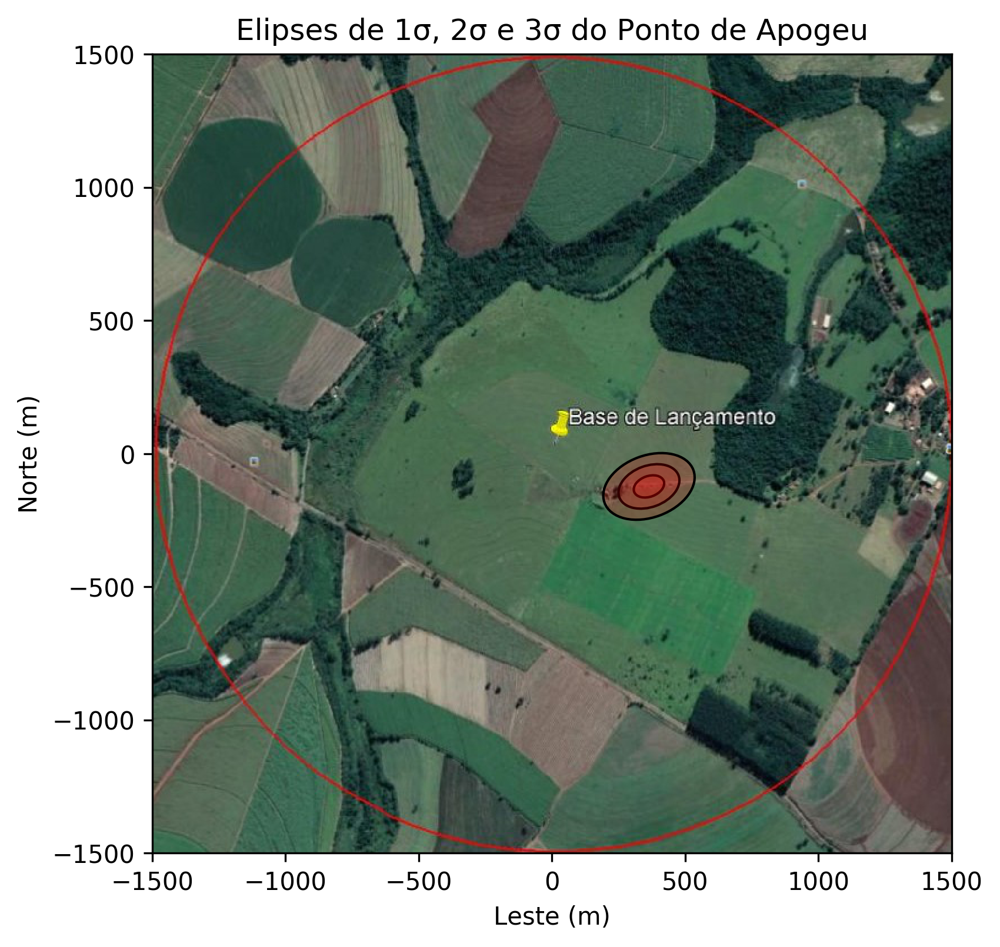

In [43]:
x = np.array(AX)
y = np.array(AY)
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse

def eigsorted(cov):
    vals, vecs = np.linalg.eigh(cov)
    order = vals.argsort()[::-1]
    return vals[order], vecs[:,order]
plt.figure(num=None, figsize=(8, 6), dpi=300, facecolor='w', edgecolor='k')
ax = plt.subplot(111)

cov = np.cov(x, y)
vals, vecs = eigsorted(cov)
theta = np.degrees(np.arctan2(*vecs[:,0][::-1]))
w, h = 2 * np.sqrt(vals)
#print(w, h)
#print(np.mean(x), np.mean(y))
for j in [1, 2, 3]:
    ell = Ellipse(xy=(np.mean(x), np.mean(y)),
                  width=w*j, height=h*j,
                  angle=theta, color='black')
    ell.set_facecolor((1, 0, 0, 0.2))
    ax.add_artist(ell)
# plt.scatter(x, y, s=0.1)
ax.set_title('Elipses de 1σ, 2σ e 3σ do Ponto de Apogeu')
ax.set_ylabel('Norte (m)')
ax.set_xlabel('Leste (m)')
plt.imshow(img,zorder=0, extent=[-1500, 1500, -1500, 1500])
plt.show()

## Distribuições Esperadas

In [44]:
print('Altitude de Apogeu - Valor Médio: ', np.mean(Z), ' m')
print('Altitude de Apogeu - Desvio Padrão: ', np.std(Z), ' m')
layout = go.Layout(
    title='Distribuição Esperada para Apogeu',
    xaxis=dict(
        title='Apogeu (m)',
    ),
    yaxis=dict(
        title='Número de ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=Z)], layout=layout)
iplot(fig, show_link=False)

Altitude de Apogeu - Valor Médio:  1728.86641157  m
Altitude de Apogeu - Desvio Padrão:  108.059627588  m


In [45]:
print('Ponto de Impacto em X (Leste) - Valor Médio: ', np.mean(X), ' m')
print('Ponto de Impacto em X (Leste) - Desvio Padrão: ', np.std(X), ' m')
layout = go.Layout(
    title='Distribuição Esperada para Ponto de Impacto em X (Leste)',
    xaxis=dict(
        title='Ponto de Impacto em X - Leste (m)',
    ),
    yaxis=dict(
        title='Número de ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=X)], layout=layout)
iplot(fig, show_link=False)

Ponto de Impacto em X (Leste) - Valor Médio:  524.147249789  m
Ponto de Impacto em X (Leste) - Desvio Padrão:  92.4662502774  m


In [46]:
print('Ponto de Impacto em Y (Norte) - Valor Médio: ', np.mean(Y), ' m')
print('Ponto de Impacto em Y (Norte) - Desvio Padrão: ', np.std(Y), ' m')
layout = go.Layout(
    title='Distribuição Esperada para Ponto de Impacto em Y (Norte)',
    xaxis=dict(
        title='Ponto de Impacto em Y - Norte (m)',
    ),
    yaxis=dict(
        title='Número de ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=Y)], layout=layout)
iplot(fig, show_link=False)

Ponto de Impacto em Y (Norte) - Valor Médio:  -204.54911639  m
Ponto de Impacto em Y (Norte) - Desvio Padrão:  56.5441772691  m


In [47]:
print('Velocidade Máxima - Valor Médio: ', np.mean(np.array(MV)/343), ' Mach')
print('Velocidade Máxima - Desvio Padrão: ', np.std(np.array(MV)/343), ' Mach')
layout = go.Layout(
    title='Distribuição Esperada para Velocidade Máxima',
    xaxis=dict(
        title='Velocidade Máxima (Mach)',
    ),
    yaxis=dict(
        title='Número de Ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=np.array(MV)/343)], layout=layout)
iplot(fig, show_link=False)

Velocidade Máxima - Valor Médio:  0.849921133636  Mach
Velocidade Máxima - Desvio Padrão:  0.0585999381049  Mach


In [48]:
print('Velocidade Na Abertura do Paraquedas - Valor Médio: ', np.mean(DV), ' m/s')
print('Velocidade Na Abertura do Paraquedas - Desvio Padrão: ', np.std(DV), ' m/s')
layout = go.Layout(
    title='Distribuição Esperada para Velocidade Na Abertura do Paraquedas',
    xaxis=dict(
        title='Velocidade Na Abertura do Paraquedas (m/s)',
    ),
    yaxis=dict(
        title='Número de Ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=DV)], layout=layout)
iplot(fig, show_link=False)

Velocidade Na Abertura do Paraquedas - Valor Médio:  0.0  m/s
Velocidade Na Abertura do Paraquedas - Desvio Padrão:  0.0  m/s


In [49]:
print('Velocidade de Impacto - Valor Médio: ', np.mean(IV), ' m/s')
print('Velocidade de Impacto - Desvio Padrão: ', np.std(IV), ' m/s')
layout = go.Layout(
    title='Distribuição Esperada para Velocidade de Impact',
    xaxis=dict(
        title='Velocidade de Impacto (m/s)',
    ),
    yaxis=dict(
        title='Número de Ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=IV)], layout=layout)
iplot(fig, show_link=False)

Velocidade de Impacto - Valor Médio:  114.49289408  m/s
Velocidade de Impacto - Desvio Padrão:  1.8067213268  m/s


In [50]:
layout = go.Layout(
    title='Distribuição Esperada para Velocidade na Saída do Trilho',
    xaxis=dict(
        title='Velocidade na Saída do Trilho (m/s)',
    ),
    yaxis=dict(
        title='Número de Ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=RV)], layout=layout)
iplot(fig, show_link=False)

In [51]:
print('Margem Estática - Valor Médio: ', np.mean(np.array(SM)), ' C')
print('Margem Estática - Desvio Padrão: ', np.std(np.array(SM)), ' C')
layout = go.Layout(
    title='Distribuição Esperada Para Margem Estática',
    xaxis=dict(
        title='Margem Estática (C)',
    ),
    yaxis=dict(
        title='Número de Ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=np.array(SM))], layout=layout)
iplot(fig, show_link=False)

Margem Estática - Valor Médio:  1.7452446722  C
Margem Estática - Desvio Padrão:  0.074419797433  C


In [52]:
print('Tempo até Apogeu - Valor Médio: ', np.mean(AT), ' s')
print('Tempo até Apogeu - Desvio Padrão: ', np.std(AT), ' s')
layout = go.Layout(
    title='Distribuição Esperada para Tempo até Apogeu',
    xaxis=dict(
        title='Tempo até Apogeu (s)',
    ),
    yaxis=dict(
        title='Número de ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=AT)], layout=layout)
iplot(fig, show_link=False)

Tempo até Apogeu - Valor Médio:  16.8379729114  s
Tempo até Apogeu - Desvio Padrão:  0.35155396766  s


In [53]:
print('Tempo até Sáida do Trilho - Valor Médio: ', np.mean(AT), ' s')
print('Tempo até Sáida do Trilho - Desvio Padrão: ', np.std(AT), ' s')
layout = go.Layout(
    title='Distribuição Esperada para Tempo até Sáida do Trilho',
    xaxis=dict(
        title='Tempo até Sáida do Trilho (s)',
    ),
    yaxis=dict(
        title='Número de ocorrências',
    )
)
fig = go.Figure(data=[Histogram(x=RT)], layout=layout)
iplot(fig, show_link=False)

Tempo até Sáida do Trilho - Valor Médio:  16.8379729114  s
Tempo até Sáida do Trilho - Desvio Padrão:  0.35155396766  s


In [54]:
import itertools as it
x, y = np.array(AX), np.array(AY)
layout = go.Layout(
    title='Densidade de Probabilidade de Localização do Apogeu',
    xaxis=dict(
        title='Leste (m)',
    ),
    yaxis=dict(
        title='Norte (m)',
    )
)
fig = go.Figure(data=[Histogram2dContour(x=x, y=y, histnorm='probability density', contours=Contours(coloring='heatmap'), colorscale='Jet'),
       Scatter(x=x[:10000], y=y[:10000], mode='markers', marker=Marker(color='white', size=1, opacity=0.5))], layout=layout)
iplot(fig, show_link=False)

In [55]:
import itertools as it
x, y = np.array(X), np.array(Y)
layout = go.Layout(
    title='Densidade de Probabilidade de Impacto do Foguete',
    xaxis=dict(
        title='Leste (m)',
    ),
    yaxis=dict(
        title='Norte (m)',
    )
)
fig = go.Figure(data=[Histogram2dContour(x=x, y=y, histnorm='probability density', contours=Contours(coloring='heatmap'), colorscale='Jet'),
       Scatter(x=x[:10000], y=y[:10000], mode='markers', marker=Marker(color='white', size=1, opacity=0.5))], layout=layout)
iplot(fig, show_link=False)